In [53]:
###################################################################
# 00_OR_online_retail_sales.ipynb
# AUTOR: FERNANDO J. HEREDIA
# FECHA: 20250403
# Análisis del comportamiento de compras de los clientes en el dataset 'online_retail'.
# OBSERVACIONES: Inspirado en el trabajo de Mario Caesar (https://www.kaggle.com/code/caesarmario/clustering-for-effective-marketing-strategy)
# OTROS ENLACES:
#    https://www.kaggle.com/code/tanmayunhale/clustering-guide-wine-dataset
#    https://www.kaggle.com/code/dexmasa/comparison-of-a-range-of-clustering-algorithms
#    https://www.kaggle.com/code/caesarmario/clustering-for-effective-marketing-strategy
#    https://www.kaggle.com/datasets/uciml/iris/data
#    https://distill.pub/2016/misread-tsne/
#    https://www.datacamp.com/es/tutorial/introduction-t-sne
###################################################################
#!pip install numpy pandas ydata-profiling pywaffle yellowbrick ipywidgets ucimlrepo plotly openpyxl 

In [54]:
###################################################################
# IMPORTAR BIBLIOTECAS
###################################################################
import numpy as np
import pandas as pd
from datetime import datetime
import math
import matplotlib.pyplot as plt
import ydata_profiling
import seaborn as sns
import warnings
import os
import yellowbrick
import scipy.cluster.hierarchy as shc
import matplotlib.patches as patches
from ucimlrepo import fetch_ucirepo #para datasets de ejemplo
from sklearn.manifold import TSNE #para TSNE
import plotly.express as px
from matplotlib.patches import Rectangle
from ydata_profiling import ProfileReport
from pywaffle import Waffle
from math import isnan
from random import sample
from numpy.random import uniform
from sklearn.neighbors import NearestNeighbors
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, OPTICS, MeanShift, estimate_bandwidth, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from sklearn.metrics import silhouette_samples, silhouette_score
from yellowbrick.style import set_palette
from yellowbrick.contrib.wrapper import wrap
%matplotlib inline

In [55]:
###################################################################
# PARÁMETROS GLOBALES
###################################################################
warnings.filterwarnings('ignore')
sns.set_style('whitegrid')
plt.rcParams['figure.dpi'] = 600
sns.set(rc = {'axes.facecolor': '#FBFBFB', 'figure.facecolor': '#FBFBFB'})
class clr:
    start = '\033[93m'+'\033[1m'
    color = '\033[93m'
    end = '\033[0m'

In [56]:
###################################################################
# IMPORTAR DATASET
###################################################################
# lectura local de dataset
#df = pd.read_csv('../data/dataset.csv', sep=',')

# usar el uci repo para obtener dataset de ejemplo
#df = pd.read_csv('data/online_retail_II.xlsx')

# Convertir a CSV (se hace una vez)
#file = 'data/online_retail_II.xlsx'
#pd.read_excel(file, sheet_name=0).to_csv('sheet1.csv', index=False)
#pd.read_excel(file, sheet_name=1).to_csv('sheet2.csv', index=False)

# Luego, leer desde CSV (MUCHO más rápido)
df = pd.concat([pd.read_csv('data/or_sheet1.csv'), pd.read_csv('data/or_sheet2.csv')])

# mostrar primeros registros del dataset
print(clr.start+'.: Imported Dataset, rows: ' +str(len(df)) +clr.end)
print(clr.color+'*' * 23)
df.head().style.background_gradient(cmap='YlOrBr').hide()

.: Imported Dataset, rows: 1067371
***********************


Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.950000,13085.000000,United Kingdom
489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.750000,13085.000000,United Kingdom
489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.750000,13085.000000,United Kingdom
489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.100000,13085.000000,United Kingdom
489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.250000,13085.000000,United Kingdom


In [57]:
###################################################################
# IDENTIFICAR Y ELIMINAR VALORES INDEFINIDOS/NULOS
###################################################################
num_missing = df.isnull().sum()
print(num_missing)
print('total filas: ', df.shape)
df.dropna(inplace = True)
df.shape
print('filas restantes: ', df.shape)

Invoice             0
StockCode           0
Description      4382
Quantity            0
InvoiceDate         0
Price               0
Customer ID    243007
Country             0
dtype: int64
total filas:  (1067371, 8)
filas restantes:  (824364, 8)


In [58]:
###################################################################
# IDENTIFICAR Y ELIMINAR REGISTROS DUPLICADOS
###################################################################
dups = df.duplicated()
print(dups.any())
print(df[dups])
print('total filas: ', df.shape)
df.drop_duplicates(inplace = True)
print('sin duplicados: ', df.shape)

True
       Invoice StockCode                        Description  Quantity  \
371     489517     21912           VINTAGE SNAKES & LADDERS         1   
383     489517     22130   PARTY CONE CHRISTMAS DECORATION          6   
384     489517     22319  HAIRCLIPS FORTIES FABRIC ASSORTED        12   
385     489517     21913     VINTAGE SEASIDE JIGSAW PUZZLES         1   
386     489517     21821   GLITTER STAR GARLAND WITH BELLS          1   
...        ...       ...                                ...       ...   
541675  581538     22068        BLACK PIRATE TREASURE CHEST         1   
541689  581538     23318     BOX OF 6 MINI VINTAGE CRACKERS         1   
541692  581538     22992             REVOLVER WOODEN RULER          1   
541699  581538     22694                       WICKER STAR          1   
541701  581538     23343       JUMBO BAG VINTAGE CHRISTMAS          1   

                InvoiceDate  Price  Customer ID         Country  
371     2009-12-01 11:34:00   3.75      16329.0  Uni

In [59]:
###################################################################
# ELIMINAR TRANSACCIONES DE REEMBOLSOS/DEVOLUCIONES
###################################################################
df=df[df['Quantity'] > 0]
print('sin reembolsos: ', df.shape)

sin reembolsos:  (779495, 8)


In [60]:
###################################################################
# FEATURE ENGINEERING
###################################################################
#LIMPIEZA Y PREPARACION INICIAL DEL DF
df.rename(columns={'Customer ID': 'CustomerID'}, inplace = True)
df=df[~(df['CustomerID'].isnull())]
#convertir a string quitandole el .0 a el identificador de cliente
df['CustomerID'] = df['CustomerID'].apply(lambda x: str(int(x)) if x.is_integer() else str(x))
# Crear nuevas columnas de Ventas y reembolsos
#df = df[~df['CustomerID'].isin([12346, 16446])] #quito outliers con altos valores de reenbolso
#df['qu_refunds'] = df['Quantity'].apply(lambda x: -x if x < 0 else 0)  #cantiad de reembolsos por transaccion
#df['qu_total'] = df['Quantity'].apply(lambda x: x if x > 0 else 0) #cantidad de ventas por transaccion
#df['qu_total'] = abs(df['Quantity'])
df['qu_sales'] = df['Quantity'].apply(lambda x: x if x > 0 else 0) #cantidad de ventas por transaccion
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'], format='%Y-%m-%d %H:%M:%S') #establecer formato de fecha
fecha_referencia = df['InvoiceDate'].max() #se define una fecha de referencia, que en este caso sera igual a la fecha de la transacción mas reciente + 1 dia
fecha_referencia = fecha_referencia + pd.Timedelta(days=1) 
df['recency_last_trx'] = (fecha_referencia - df['InvoiceDate']).dt.total_seconds() / 86400 #cantidad de dias desde la fecha de referencia (recencia) por transaccion.
df['qa_sales'] = df['qu_sales'] * df['Price'] #cantidad en dinero de las ventas
#df['a_total'] = abs(df['qu_total']) * df['Price'] #cantiadad en dinero por transaccion

#-------------------------------------------------------------------
#subprocedimiento para obtener la cantidad de facturas de los meses anteriores para cada cliente
dfaux3 = df
customers =  pd.DataFrame({
  "key": '0',
  "CustomerID": dfaux3['CustomerID'].unique()
})
dates =  pd.DataFrame({
  "key": '0',
  "YearMonth": dfaux3['InvoiceDate'].dt.to_period('M').unique()
})
customers = customers.merge(dates, on='key', how='outer') #

dfaux3['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])
dfaux3['YearMonth'] = dfaux3['InvoiceDate'].dt.to_period('M')
dfaux3 = dfaux3.groupby(['CustomerID', 'YearMonth']).agg(
    sqi_sales_201112 = ('InvoiceDate', 'nunique')
).reset_index()
dfaux3 = customers.merge(dfaux3[['CustomerID', 'YearMonth', 'sqi_sales_201112']], on=['CustomerID', 'YearMonth'], how='left')
dfaux3 = dfaux3.fillna(0) #reemplazo valores NaN por 0
dfaux3['sqi_sales_201111'] = dfaux3['sqi_sales_201112'].shift(1)
dfaux3['sqi_sales_201110'] = dfaux3['sqi_sales_201112'].shift(2)
dfaux3['sqi_sales_201109'] = dfaux3['sqi_sales_201112'].shift(3)
dfaux3 = dfaux3[dfaux3['YearMonth'] == '2011-12']
dfaux3 = dfaux3.iloc[:, [1, 3, 4, 5, 6]] #ordeno las columnas del df.

#-------------------------------------------------------------------
#subprocedimiento para obtener la cantidad de facturas por año para cada cliente
dfaux4 = df
customers =  pd.DataFrame({
  "key": '0',
  "CustomerID": dfaux4['CustomerID'].unique()
})
dates =  pd.DataFrame({
  "key": '0',
  #"YearMonth": dfaux4['InvoiceDate'].dt.to_period('M').unique()
  "Year": df['InvoiceDate'].dt.year.unique()  # Extraer el año
})
customers = customers.merge(dates, on='key', how='outer') #
dfaux4['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])
dfaux4['Year'] = dfaux4['InvoiceDate'].dt.year
dfaux4 = dfaux4.groupby(['CustomerID', 'Year']).agg(
    sqi_sales_year = ('InvoiceDate', 'nunique')
).reset_index()
dfaux4 = customers.merge(dfaux4[['CustomerID', 'Year', 'sqi_sales_year']], on=['CustomerID', 'Year'], how='left')
dfaux4 = dfaux4.fillna(0) #reemplazo valores NaN por 0
dfaux4['sqi_sales_year'] = pd.to_numeric(dfaux4['sqi_sales_year'], downcast='integer', errors='coerce') #convierto las cantidades a numero entero.
dfaux4['Year'] = 'sqi_sales_' + dfaux4['Year'].astype(str)
dfaux4 = dfaux4.pivot(index=["CustomerID"], columns="Year", values="sqi_sales_year").reset_index() #cambio a formato horizontal

#-------------------------------------------------------------------
#ENSAMBLE DEL DF DEFINITIVO
df = df.groupby('CustomerID').agg(
    q_recency_last_trx = ('recency_last_trx', 'min'), #recencia en dias desde la ultima transaccion
    last_trx_date = ('InvoiceDate', 'max'), #fecha de la ultima transaccion
    first_trx_date = ('InvoiceDate', 'min'), #fecha de la primer transaccion
    sqi_sales = ('InvoiceDate', 'nunique'),
    sqa_sales = ('qa_sales', 'sum'),
    squ_sales = ('qu_sales', 'sum') #sumatoria de la cantidad de unidades vendidas
).reset_index()

df['q_recency_first_trx']  = (fecha_referencia - df['first_trx_date']).dt.total_seconds() / 86400 #recencia en dias de la primer transaccion
df['q_first_last_trx_span']  = (df['last_trx_date'] - df['first_trx_date']).dt.total_seconds() / 86400 #intervalo en dias entre la primer y ultima transaccion
df.drop('last_trx_date', axis=1, inplace=True) #elimino variable secundaria
df.drop('first_trx_date', axis=1, inplace=True) #elimino variable secundaria
df = df.merge(dfaux3[['CustomerID', 'sqi_sales_201112', 'sqi_sales_201111', 'sqi_sales_201110', 'sqi_sales_201109']], on=['CustomerID'], how='left') #junta con dfaux3
df = df.merge(dfaux4[['CustomerID', 'sqi_sales_2011', 'sqi_sales_2010', 'sqi_sales_2009']], on=['CustomerID'], how='left') #junta con dfaux4
#df = df.iloc[:, [0, 2, 3, 4, 7, 8, 9, 10, 11, 12, 20, 21, 22, 23, 1, 5, 6, 13, 14, 15, 16, 17, 18, 19]] #ordeno las columnas del df.
#df
df
#df.to_csv('output/test.csv', sep=',')

,CustomerID,q_recency_last_trx,sqi_sales,sqa_sales,squ_sales,q_recency_first_trx,q_first_last_trx_span,sqi_sales_201112,sqi_sales_201111,sqi_sales_201110,sqi_sales_201109,sqi_sales_2011,sqi_sales_2010,sqi_sales_2009
0,12346,326.117361,12,77556.46,74285,726.177778,400.060417,0.0,0.0,0.0,0.0,1,6,5
1,12347,2.873611,8,4921.53,2967,404.937500,402.063889,1.0,0.0,1.0,0.0,6,2,0
2,12348,75.984028,5,2019.40,2714,438.910417,362.926389,0.0,0.0,0.0,1.0,3,2,0
3,12349,19.124306,4,4428.69,1624,589.979167,570.854861,0.0,1.0,0.0,0.0,1,3,0
4,12350,310.867361,1,334.40,197,310.867361,0.000000,0.0,0.0,0.0,0.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5876,18283,4.033333,22,2664.90,1679,658.815278,654.781944,1.0,4.0,1.0,1.0,16,6,0
5877,18284,432.053472,1,461.68,494,432.053472,0.000000,0.0,0.0,0.0,0.0,0,1,0
5878,18285,661.101389,1,427.00,145,661.101389,0.000000,0.0,0.0,0.0,0.0,0,1,0
5879,18286,477.036806,2,1296.43,608,724.086806,247.050000,0.0,0.0,0.0,0.0,0,1,1


In [ ]:
###################################################################
# PROFILING
###################################################################
ProfileReport(df, title='Dataset Report', minimal=True, progress_bar=False, samples=None, correlations=None, interactions=None, explorative=True, notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#FFCC00'}}, missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

In [61]:
###################################################################
# ELIMINAR OUTLIERS
###################################################################
dfi = df #creacion de dfi (data frame auxiliar con las variables elegidas)
outliers = df
dfi = dfi.drop('CustomerID', axis = 1) #se debe quitar siempre
outliersi = dfi #crear df que contendrá outliers
#defino los rangos para los cuales filtrar outliers
Q1 = dfi.quantile(0.02)
Q3 = dfi.quantile(0.98)
IQR = Q3 - Q1
#filtro outliers
dfi = dfi[~((dfi < (Q1 - 1.5 * IQR)) | (dfi > (Q3 + 1.5 * IQR))).any(axis=1)]
#actualizo el df de outliers
keys = list(dfi.columns.values)
i1 = outliersi.set_index(keys).index
i2 = dfi.set_index(keys).index
outliersi = outliersi[~i1.isin(i2)]
#imprimir resultados
print(f"Antes: {df.shape[0]}, Después: {dfi.shape[0]}, outliers: {outliersi.shape[0]}")
df = df[df.index.isin(dfi.index)] #filtra outliers en df original
outliers = outliers[outliers.index.isin(outliersi.index)] #filtra outliers en df original

Antes: 5881, Después: 5797, outliers: 84


In [62]:
#dfi['lsqu_sales'] = np.log((dfi['squ_sales']+1))
#dfi['lsqi_sales'] = np.log((dfi['sqi_sales']+1))
#dfi['lsqa_sales'] = np.log((dfi['sqa_sales']+1))

dfi['lsqi_sales_2011'] = np.log((dfi['sqi_sales_2011']+1))
dfi['lsqi_sales_2010'] = np.log((dfi['sqi_sales_2010']+1))
#dfi['lq_recency_last_trx'] = np.log((dfi['q_recency_last_trx']))
dfi['lq_first_last_trx_span'] = np.log((dfi['q_first_last_trx_span']) + 1)
#dfi['lsqi_sales_2009'] = np.log((dfi['sqi_sales_2009']+1))
#dfi['l_sqa_squ_sales'] = np.log((dfi['sqa_sales'] / dfi['squ_sales'])+1)

dfi = dfi.drop('squ_sales', axis = 1)
dfi = dfi.drop('sqi_sales', axis = 1)
#dfi = dfi.drop('sqa_sales', axis = 1)
#dfi = dfi.drop('q_recency_last_trx', axis = 1)
dfi = dfi.drop('q_recency_first_trx', axis = 1)
dfi = dfi.drop('q_first_last_trx_span', axis = 1)
dfi = dfi.drop('sqi_sales_201112', axis = 1)
dfi = dfi.drop('sqi_sales_201111', axis = 1)
dfi = dfi.drop('sqi_sales_201110', axis = 1)
dfi = dfi.drop('sqi_sales_201109', axis = 1)
dfi = dfi.drop('sqi_sales_2011', axis = 1)
dfi = dfi.drop('sqi_sales_2010', axis = 1)
dfi = dfi.drop('sqi_sales_2009', axis = 1)
dfi

,q_recency_last_trx,sqa_sales,lsqi_sales_2011,lsqi_sales_2010,lq_first_last_trx_span
1,2.873611,4921.53,1.945910,1.098612,5.999095
2,75.984028,2019.40,1.386294,1.098612,5.896952
3,19.124306,4428.69,0.693147,1.386294,6.348885
4,310.867361,334.40,0.693147,0.000000,0.000000
5,375.893750,300.93,0.000000,0.693147,0.000000
...,...,...,...,...,...
5876,4.033333,2664.90,2.833213,1.945910,6.485828
5877,432.053472,461.68,0.000000,0.693147,0.000000
5878,661.101389,427.00,0.000000,0.693147,0.000000
5879,477.036806,1296.43,0.000000,0.693147,5.513630


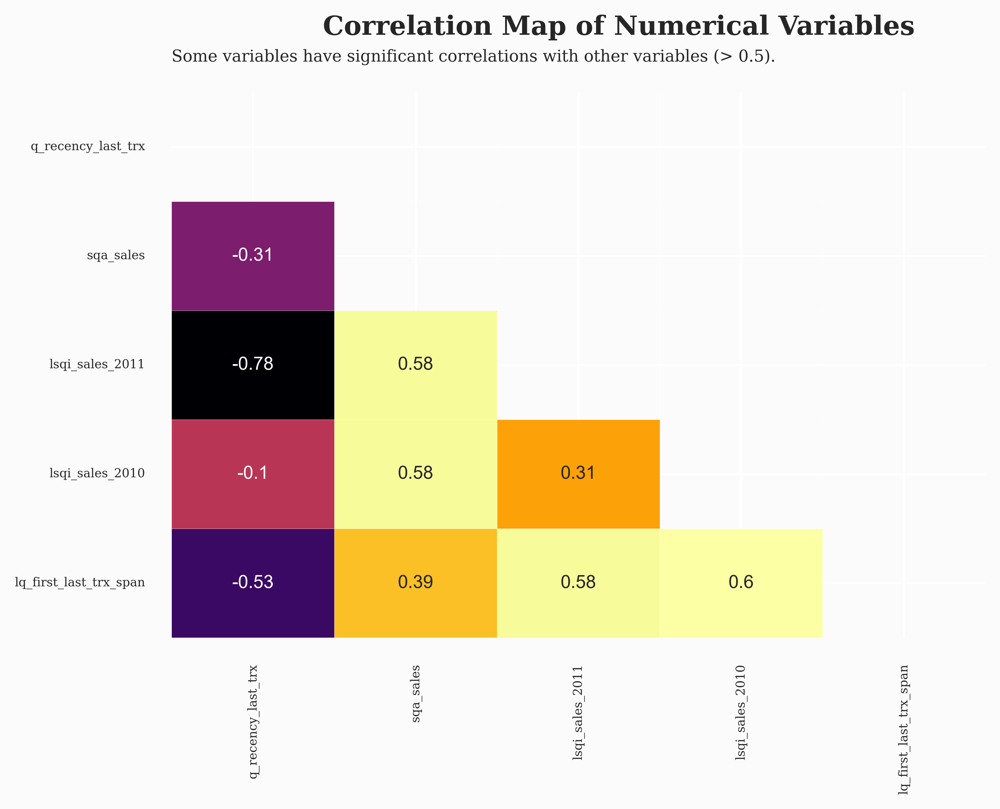

.: Dataframe after Dropping Variables :.
*****************************************


q_recency_last_trx,sqa_sales,lsqi_sales_2011,lsqi_sales_2010,lq_first_last_trx_span
2.873611,4921.530000,1.945910,1.098612,5.999095
75.984028,2019.400000,1.386294,1.098612,5.896952
19.124306,4428.690000,0.693147,1.386294,6.348885
310.867361,334.400000,0.693147,0.000000,0.000000
375.893750,300.930000,0.000000,0.693147,0.000000


In [63]:
###################################################################
# DIAGRAMA DE CORRELACIÓN
###################################################################
mask = np.triu(np.ones_like(dfi.corr(), dtype=bool))
fig, ax = plt.subplots(figsize=(7, 6))
sns.heatmap(dfi.corr(), mask=mask, annot=True, cmap='inferno', linewidths=0.1, cbar=False, annot_kws={"size":9})
yticks, ylabels = plt.yticks()
xticks, xlabels = plt.xticks()
ax.set_xticklabels(xlabels, size=6, fontfamily='serif')
ax.set_yticklabels(ylabels, size=6, fontfamily='serif')
plt.suptitle('Correlation Map of Numerical Variables', fontweight='heavy', x=0.327, y=0.96, ha='left', fontsize=13, fontfamily='serif')
plt.title('Some variables have significant correlations with other variables (> 0.5).\n', fontsize=8, fontfamily='serif', loc='left')
plt.tight_layout(rect=[0, 0.04, 1, 1.01])
plt.show();

###################################################################
# VISTA PREVIA DE DF
###################################################################

print(clr.start+'.: Dataframe after Dropping Variables :.'+clr.end)
print(clr.color+'*' * 41)
dfi.head().style.background_gradient(cmap='afmhot_r').hide()


In [64]:
###################################################################
# REVISAR COLINEALIDAD
###################################################################
det_corr = np.linalg.det(dfi.corr())
print(f"Determinante de la matriz de correlación: {det_corr:.6f}")

from statsmodels.stats.outliers_influence import variance_inflation_factor

# Calcular VIF para cada variable
vif_data = pd.DataFrame()
vif_data["Variable"] = dfi.columns
vif_data["VIF"] = [variance_inflation_factor(dfi.values, i) for i in range(dfi.shape[1])]

print(vif_data)

Determinante de la matriz de correlación: 0.062731
                 Variable       VIF
0      q_recency_last_trx  1.493985
1               sqa_sales  2.865252
2         lsqi_sales_2011  4.803327
3         lsqi_sales_2010  5.901512
4  lq_first_last_trx_span  6.867310


In [65]:
###################################################################
# NORMALIZACIÓN
###################################################################
#standard scaling
X = pd.DataFrame(StandardScaler().fit_transform(dfi))
#vista de DF normalizado
X.head().style.background_gradient(cmap='afmhot_r')

,0,1,2,3,4
0,-0.959989,0.851253,1.324444,0.186681,0.752465
1,-0.611213,0.000875,0.602848,0.186681,0.714497
2,-0.882465,0.706842,-0.290929,0.547643,0.882484
3,0.509305,-0.492862,-0.290929,-1.191776,-1.477444
4,0.819516,-0.502669,-1.184707,-0.322067,-1.477444


In [66]:
###################################################################
# TEST DE CLUSTERING: HOPKINS
# H0: Los datos siguen una distribución uniforme aleatoria en el espacio de características, es decir, no tienen estructura de clusters.
# HA: Los datos no están distribuidos aleatoriamente, lo que sugiere la presencia de clusters naturales.
# DESEABLE: Rechazar H0 y quedarse con la HA. (0.75 < H < 0.99)
#  H cercano a 1: se encuentra una estructura con clusteres (Rechaza H0)
###################################################################
# --- Hopkins Test (codes by Matevž Kunaver: https://matevzkunaver.wordpress.com/2017/06/20/hopkins-test-for-cluster-tendency/) ---
def hopkins(X):
    d = X.shape[1]
    n = len(X)
    m = int(0.1 * n)
    nbrs = NearestNeighbors(n_neighbors=1).fit(X)

    rand_X = sample(range(0, n, 1), m)

    ujd = []
    wjd = []
    for j in range(0, m):
        u_dist, _ = nbrs.kneighbors(uniform(np.amin(X,axis=0),np.amax(X,axis=0),d).reshape(1, -1), 2, return_distance=True)
        ujd.append(u_dist[0][1])
        w_dist, _ = nbrs.kneighbors(X.iloc[rand_X[j]].values.reshape(1, -1), 2, return_distance=True)
        wjd.append(w_dist[0][1])

    H = sum(ujd) / (sum(ujd) + sum(wjd))
    if isnan(H):
        print (ujd, wjd)
        H = 0

    return H

# --- Perform Hopkins Test ---
hopkins_value = hopkins(X)
hopkins_result = 'Result: '+clr.start+'{:.4f}'.format(hopkins_value)+clr.end
print(clr.start+'.: Hopkins Test :.'+clr.end)
print(clr.color+'*' * 19+clr.end)
print(hopkins_result)
if  0.7 < hopkins_value < 1:
    print('>> From the result above,'+clr.color+' it has a high tendency to cluster (contains meaningful clusters)'+clr.end)
    print('\n'+clr.color+'*' * 31+clr.end)
    print(clr.start+'.:. Conclusions: Accept H0 .:.'+clr.end)
    print(clr.color+'*' * 31+clr.end)
else:
    print('>> From the result above,'+clr.color+' it has no meaningful clusters'+clr.end)
    print('\n'+clr.color+'*' * 31+clr.end)
    print(clr.start+'.:. Conclusions: Reject H0 .:.'+clr.end)
    print(clr.color+'*' * 31+clr.end)

.: Hopkins Test :.
*******************
Result: 0.9603
>> From the result above, it has a high tendency to cluster (contains meaningful clusters)

*******************************
.:. Conclusions: Accept H0 .:.
*******************************


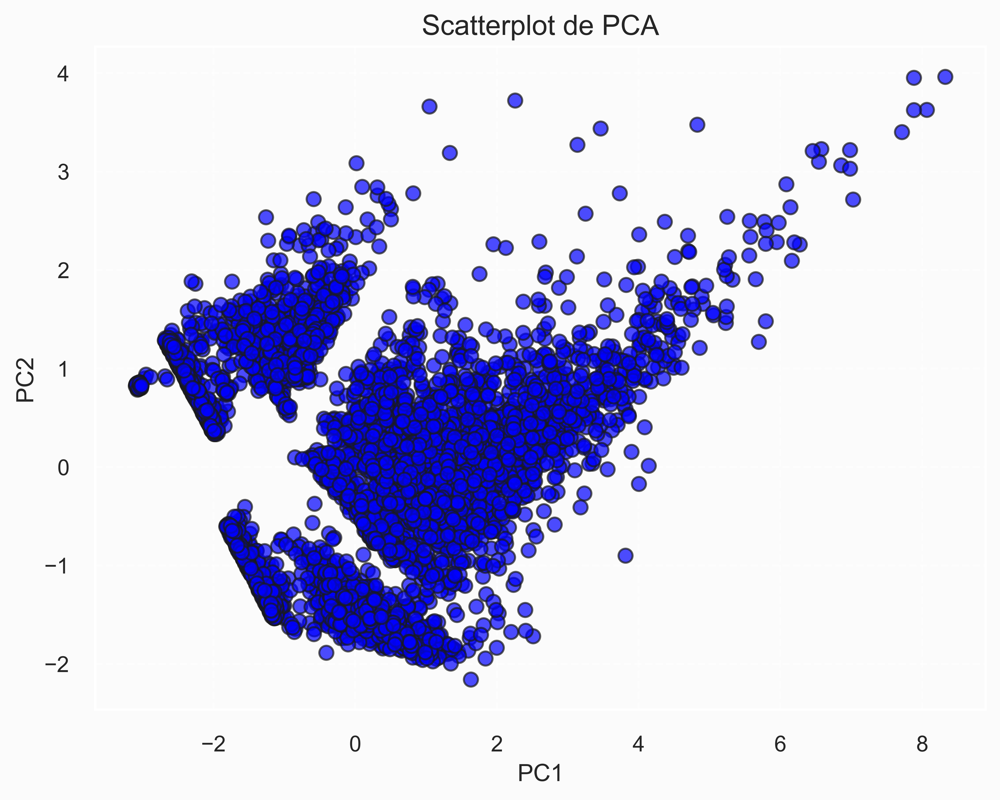

Porcentaje de varianza explicada por cada componente:
  Componente  Varianza Explicada (%)
0        PC1               58.453188
1        PC2               21.993373
matriz de loadings:
                             PC1       PC2
q_recency_last_trx     -0.426576  0.592006
sqa_sales               0.433672  0.316829
lsqi_sales_2011         0.507154 -0.337019
lsqi_sales_2010         0.381863  0.655715
lq_first_last_trx_span  0.476378  0.074863


In [67]:
###################################################################
# PCA
###################################################################
#Convertir a array para reducir la dimensionalidad
X = np.asarray(X)
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X)

# --- Graficar las componentes principales ---
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], color='blue', alpha=0.7, edgecolor='k', s=50)

# Etiquetas del eje
plt.xlabel('PC1', fontsize=12)
plt.ylabel('PC2', fontsize=12)
plt.title('Scatterplot de PCA', fontsize=14)

# Mostrar el gráfico
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Varianza explicada por cada componente
explained_variance = pd.DataFrame(
    {
        'Componente': [f'PC{i+1}' for i in range(pca.n_components_)],
        'Varianza Explicada (%)': pca.explained_variance_ratio_ * 100
    }
)

print("Porcentaje de varianza explicada por cada componente:")
print(explained_variance)
print('matriz de loadings:')
# Obtener los 'loadings' o pesos de cada variable en cada componente principal
loadings = pd.DataFrame(pca.components_.T, 
                        columns=[f'PC{i+1}' for i in range(len(pca.components_))],
                        index=dfi.columns)

print(loadings)

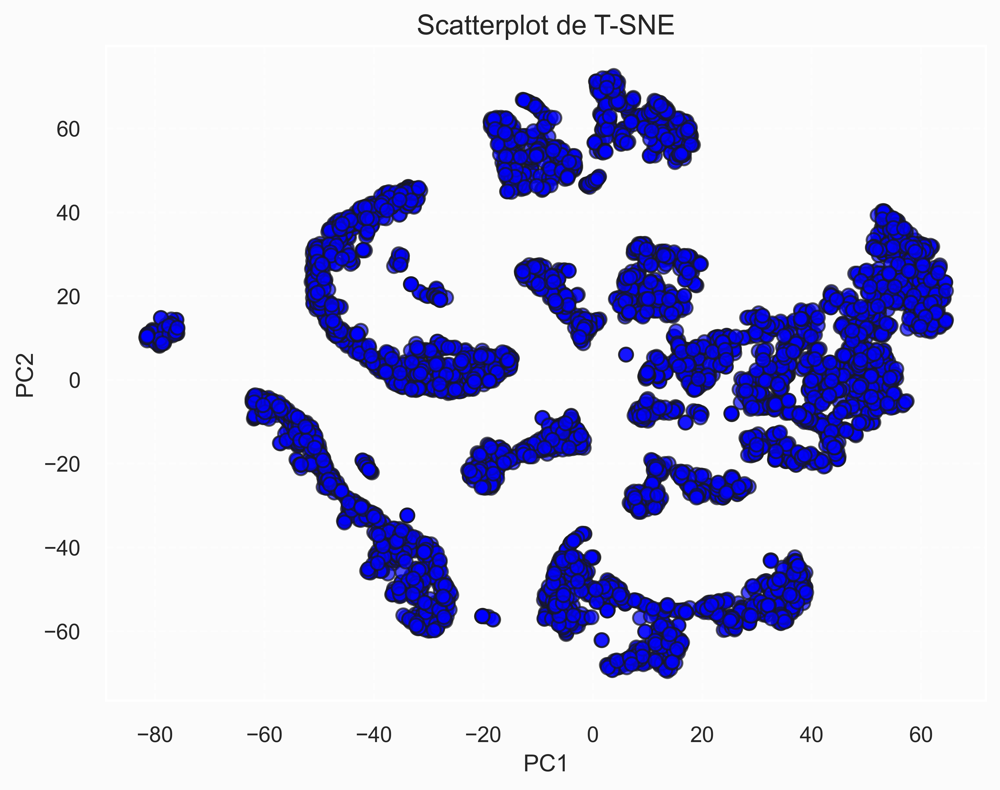

In [68]:
###################################################################
# OPCIONAL: TSNE
###################################################################
tsne = TSNE(n_components=2, perplexity=40, random_state=42)
X_tsne = tsne.fit_transform(X)
#tsne.kl_divergence_

# --- Graficar las componentes principales ---
plt.figure(figsize=(8, 6))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], color='blue', alpha=0.7, edgecolor='k', s=50)

# Etiquetas del eje
plt.xlabel('PC1', fontsize=12)
plt.ylabel('PC2', fontsize=12)
plt.title('Scatterplot de T-SNE', fontsize=14)

# Mostrar el gráfico
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

###################################################################
# ELECCION DE UTILIZAR PCA o todas las dimensiones
###################################################################

X = X_pca
#X


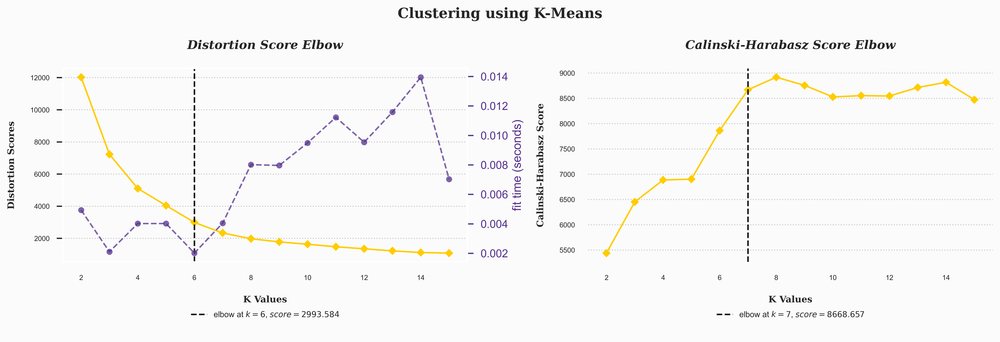

In [70]:
###################################################################
# TÉCNICAS DE ELBOW PARA ENCONTRAR EL NÚMERO DE CLUSTERES
###################################################################
def kmeans():
    # --- Figures Settings ---
    color_palette=['#FFCC00', '#54318C']
    set_palette(color_palette)
    title=dict(fontsize=12, fontweight='bold', style='italic', fontfamily='serif')
    text_style=dict(fontweight='bold', fontfamily='serif')
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

    # --- Elbow Score ---
    elbow_score = KElbowVisualizer(KMeans(random_state=32, max_iter=500), k=(2, 16), ax=ax1)
    elbow_score.fit(X)
    elbow_score.finalize()
    elbow_score.ax.set_title('Distortion Score Elbow\n', **title)
    elbow_score.ax.tick_params(labelsize=7)
    for text in elbow_score.ax.legend_.texts:
        text.set_fontsize(9)
    for spine in elbow_score.ax.spines.values():
        spine.set_color('None')
    elbow_score.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), borderpad=2, frameon=False, fontsize=8)
    elbow_score.ax.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    elbow_score.ax.grid(axis='x', alpha=0)
    elbow_score.ax.set_xlabel('\nK Values', fontsize=9, **text_style)
    elbow_score.ax.set_ylabel('Distortion Scores\n', fontsize=9, **text_style)

    # --- Elbow Score (Calinski-Harabasz Index) ---
    elbow_score_ch = KElbowVisualizer(KMeans(random_state=32, max_iter=500), k=(2, 16), metric='calinski_harabasz', timings=False, ax=ax2)
    elbow_score_ch.fit(X)
    elbow_score_ch.finalize()
    elbow_score_ch.ax.set_title('Calinski-Harabasz Score Elbow\n', **title)
    elbow_score_ch.ax.tick_params(labelsize=7)
    for text in elbow_score_ch.ax.legend_.texts:
        text.set_fontsize(9)
    for spine in elbow_score_ch.ax.spines.values():
        spine.set_color('None')
    elbow_score_ch.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), borderpad=2, frameon=False, fontsize=8)
    elbow_score_ch.ax.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    elbow_score_ch.ax.grid(axis='x', alpha=0)
    elbow_score_ch.ax.set_xlabel('\nK Values', fontsize=9, **text_style)
    elbow_score_ch.ax.set_ylabel('Calinski-Harabasz Score\n', fontsize=9, **text_style)

    plt.suptitle('Clustering using K-Means', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();

# --- Calling K-Means Functions ---
kmeans();

In [71]:
# Función para mostrar Silhouette Plot y Scatter Plot en un mismo gráfico
def plot_combined(model, y_model):

    colors = [
        "#FFBB00", "#3C096C", "#9D4EDD", "#0096C7", "#E63946", 
        "#2A9D8F", "#F4A261", "#264653", "#6D597A", "#4CAF50", 
        "#FF6D00", "#8338EC"
    ]
    
    title = dict(fontsize=12, fontweight='bold', style='italic', fontfamily='serif')
    text_style = dict(fontweight='bold', fontfamily='serif')
    scatter_style = dict(linewidth=0.65, edgecolor='#100C07', alpha=0.85)
    scatter_style_centroids = dict(linewidth=1, edgecolor='#100C07', alpha=1)
    legend_style = dict(borderpad=2, frameon=False, fontsize=8)
    
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # --- Gráfico 1: Diagrama de Dispersión ---
    unique_labels = np.unique(y_model)
    legend_elements = []  # Para construir la leyenda
    
    for i in unique_labels:
        if i == -1:  # Outliers
            scatter = axes[0].scatter(X[y_model == i, 0], X[y_model == i, 1], 
                                      s=50, c="black", marker="x", alpha=0.7)
            legend_elements.append((scatter, "Outliers"))
        else:
            scatter = axes[0].scatter(X[y_model == i, 0], X[y_model == i, 1], 
                                      s=50, c=colors[i], **scatter_style)
            legend_elements.append((scatter, f"Cluster {i+1}"))
    
    # Intentar graficar los centroides
    try:
        if isinstance(model, KMeans) or isinstance(model, MeanShift):
            centroids = model.cluster_centers_
        elif isinstance(model, GaussianMixture):
            centroids = model.means_
        else:
            raise AttributeError  # Forzar excepción si no tiene centroides
        scatter_centroids = axes[0].scatter(centroids[:, 0], centroids[:, 1], 
                                            c="black", marker="x", s=200, 
                                            label="Centroids", **scatter_style_centroids)
        legend_elements.append((scatter_centroids, "Centroids"))
    except AttributeError:
        print("El algoritmo seleccionado no tiene centroides definidos, solo se grafican los clusters.")

    axes[0].set_title(f"MODELO: {model}", **title)
    axes[0].legend([e[0] for e in legend_elements], [e[1] for e in legend_elements], 
                   bbox_to_anchor=(0.95, -0.05), ncol=5, **legend_style)
    axes[0].grid(axis='both', alpha=0.5, color='#9B9A9C', linestyle='dotted')

    # --- Gráfico 2: Silhouette Plot ---
    mask = y_model != -1
    X_filtered = X[mask]
    labels_filtered = y_model[mask]

    if len(np.unique(labels_filtered)) > 1:  # Silhouette solo si hay más de un cluster
        silhouette_avg = silhouette_score(X_filtered, labels_filtered)
        silhouette_values = silhouette_samples(X_filtered, labels_filtered)

        y_lower = 10
        for i in np.unique(labels_filtered):
            cluster_silhouette_values = silhouette_values[labels_filtered == i]
            cluster_silhouette_values.sort()
            size_cluster_i = len(cluster_silhouette_values)
            y_upper = y_lower + size_cluster_i
            axes[1].fill_betweenx(np.arange(y_lower, y_upper), 0, cluster_silhouette_values, 
                                  alpha=0.5, edgecolor=colors[i], facecolor=colors[i])
            y_lower = y_upper + 10  # Espaciado entre clusters
        
        axes[1].axvline(x=silhouette_avg, color="red", linestyle="--", label="Silhouette Score Medio")
    else:
        axes[1].text(0.5, 0.5, "No se puede calcular el Silhouette con un solo cluster",
                     horizontalalignment='center', verticalalignment='center', fontsize=12)

    axes[1].set_title('Silhouette Plots of Clusters\n', **title)
    axes[1].grid(axis='x', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    axes[1].grid(axis='y', alpha=0)
    axes[1].set_xlabel('\nCoefficient Values', fontsize=9, **text_style)
    axes[1].set_ylabel('Cluster Labels\n', fontsize=9, **text_style)

    # Ajustar diseño
    plt.tight_layout()
    plt.show()

def evaluate_clustering(X, y):
    db_index = round(davies_bouldin_score(X, y), 3)
    s_score = round(silhouette_score(X, y), 3)
    ch_index = round(calinski_harabasz_score(X, y), 3)
    print(clr.start+'.: Evaluate Clustering Quality :.'+clr.end)
    print(clr.color+'*' * 34+clr.end)
    print('.: Davies-Bouldin Index: '+clr.start, db_index)
    print(clr.end+'.: Silhouette Score: '+clr.start, s_score)
    print(clr.end+'.: Calinski Harabasz Index: '+clr.start, ch_index)
    return db_index, s_score, ch_index

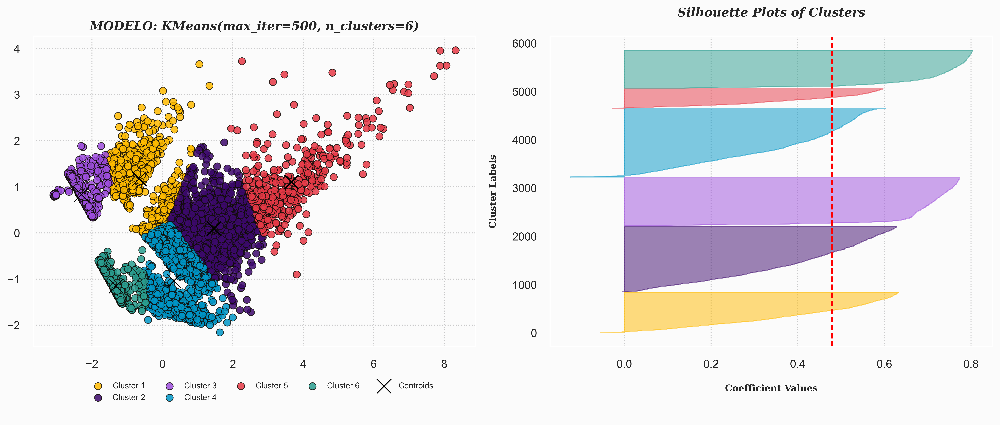

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  0.715
.: Silhouette Score:  0.479
.: Calinski Harabasz Index:  7863.163


In [72]:
###################################################################
# KMEANS
# Descripción: Divide los datos en K clusters basados en centroides, minimizando la varianza dentro de cada cluster.
# Indicación: Adecuado para datos bien separados en grupos esféricos o aproximadamente gaussianos.
# Ventajas: Escalable, simple y eficiente.
# Desventajas: Necesario definir K de antemano, sensible a outliers, supone clusters esféricos.
# Supuestos: Los datos deben agruparse en grupos aproximadamente esféricos. La varianza de cada cluster debe ser similar.
# Hiperparámetros:
#     K: cantidad de clusters (cant_cluster).
###################################################################
cant_cluster = 6
labels = [f"Cluster {i+1}" for i in range(cant_cluster)] + ["Centroids"]
kmeans = KMeans(n_clusters=cant_cluster, max_iter=500)
y_kmeans = kmeans.fit_predict(X)

plot_combined(kmeans, y_kmeans)
###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################
db_kmeans, ss_kmeans, ch_kmeans = evaluate_clustering(X, y_kmeans)

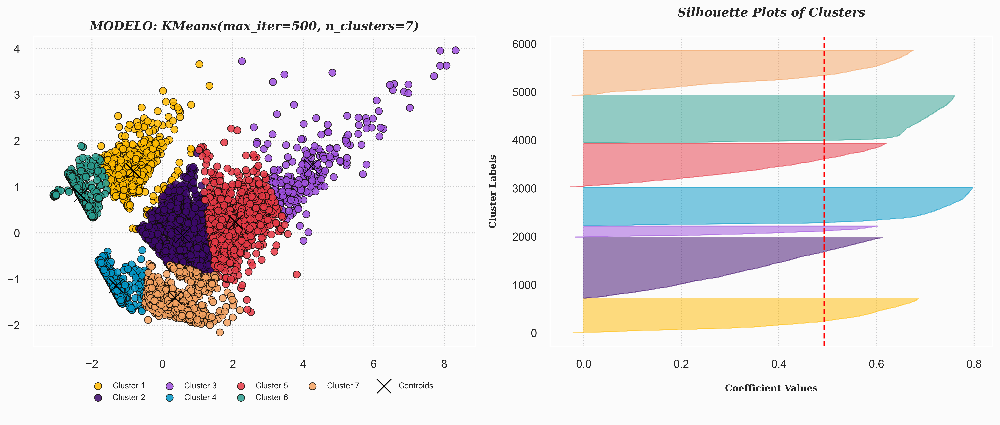

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  0.688
.: Silhouette Score:  0.493
.: Calinski Harabasz Index:  8669.839


In [73]:
###################################################################
# KMEANS++
# Descripción: Divide los datos en K clusters basados en centroides, minimizando la varianza dentro de cada cluster.
# Indicación: Adecuado para datos bien separados en grupos esféricos o aproximadamente gaussianos.
# Ventajas: Escalable, simple y eficiente.
# Desventajas: Necesario definir K de antemano, sensible a outliers, supone clusters esféricos.
# Supuestos: Los datos deben agruparse en grupos aproximadamente esféricos. La varianza de cada cluster debe ser similar.
# Hiperparámetros:
#     K: cantidad de clusters (cant_cluster).
###################################################################
cant_cluster = 7
labels = [f"Cluster {i+1}" for i in range(cant_cluster)] + ["Centroids"]
kmeans_pplus = KMeans(n_clusters=cant_cluster, init="k-means++", max_iter=500)
y_kmeans_pplus = kmeans_pplus.fit_predict(X)

plot_combined(kmeans_pplus, y_kmeans_pplus)
###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################
db_kmeans_pplus, ss_kmeans_pplus, ch_kmeans_pplus = evaluate_clustering(X, y_kmeans_pplus)

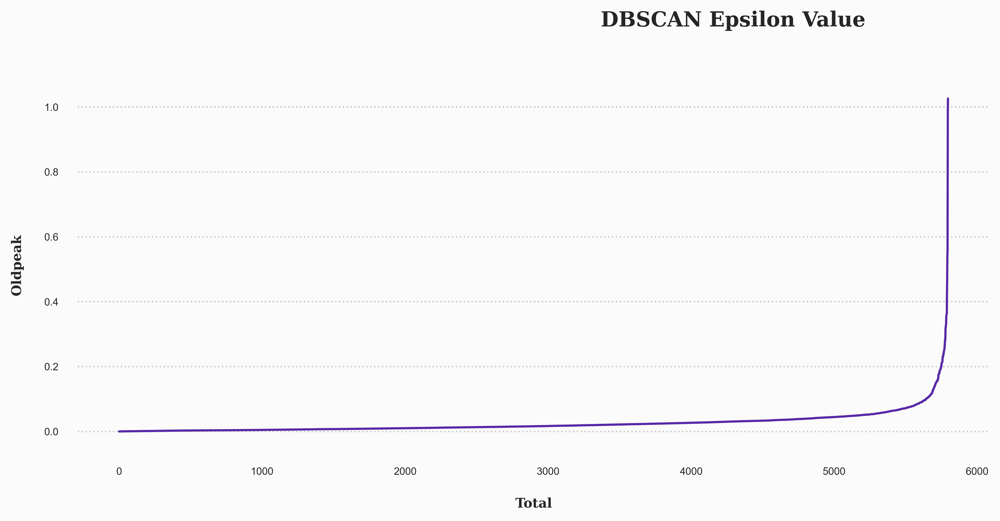

In [74]:
###################################################################
# GRÁFICA DE DISTANCIAS PARA DEFINIR LOS VALORES EPSILON DEL ALGORITMO DBSCAN
#     Buscar una valor aproximado al codo (elbow), donde la curva cambia bruscamente.
#     Antes del codo: Las distancias crecen lentamente, lo que indica puntos densamente agrupados (posibles clusters).
#     Después del codo: Las distancias crecen rápidamente, lo que indica la transición hacia los "ruidos" o puntos atípicos (outliers).
###################################################################

def epsilon():

    # --- Calculate Nearest Neighbors ---
    neighbors=NearestNeighbors(n_neighbors=2)
    nbrs=neighbors.fit(X)
    distances, indices=nbrs.kneighbors(X)
    distances=np.sort(distances, axis = 0)

    # --- Figure Settings ---
    bbox=dict(boxstyle='round', pad=0.3, color='#FFDA47', alpha=0.6)
    txt1=dict(textcoords='offset points', va='center', ha='center', fontfamily='serif', style='italic')
    txt2=dict(textcoords='offset points', va='center', fontfamily='serif', style='italic')
    kw=dict(arrowstyle='Simple, tail_width=0.1, head_width=0.4, head_length=1', color='black')
    text_style=dict(fontweight='bold', fontfamily='serif')
    fig=plt.figure(figsize=(14, 5))

    # --- Epsilon Plot ---
    distances_1=distances[:, 1]
    ax1=fig.add_subplot(1, 3, (1, 2))
    plt.plot(distances_1, color='#5829A7')
    plt.xlabel('\nTotal', fontsize=9, **text_style)
    plt.ylabel('Oldpeak\n', fontsize=9, **text_style)
    for spine in ax1.spines.values():
        spine.set_color('None')
    plt.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    plt.grid(axis='x', alpha=0)
    plt.tick_params(labelsize=7)

    plt.suptitle('DBSCAN Epsilon Value\n', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();

# --- Calling Epsilon Functions ---
epsilon();

El algoritmo seleccionado no tiene centroides definidos, solo se grafican los clusters.


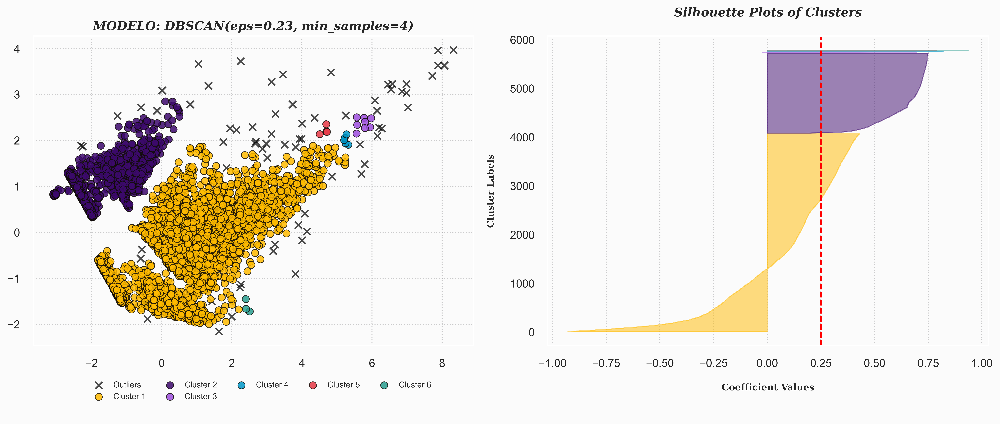

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  1.483
.: Silhouette Score:  0.24
.: Calinski Harabasz Index:  833.056


In [75]:
###################################################################
# DBSCAN
# Descripción: Identifica clusters como regiones densas de puntos separadas por áreas escasamente pobladas.
# Indicación: Adecuado para clusters de formas arbitrarias y con ruido.
# Ventajas: No es necesario definir K. Detecta outliers como ruido. Funciona bien con clusters no esféricos.
# Desventajas: No es adecuado para clusters con densidades diferentes. Poco escalable, lento en datasets grandes.
# Supuestos: Los clusters son regiones densas separadas por regiones menos densas.
# Hiperparámetros: 
#     Epsilon (eps): distancia máxima entre dos puntos para que sean considerados vecinos (formen parte del mismo cluster). Mirar la gráfica K distancias.
#     Min pts (min samples): número mínimo de puntos para formar un cluster. Por regla general es 2*cantidad de variables.
# Enlaces: https://www.datacamp.com/tutorial/dbscan-clustering-algorithm
###################################################################
dbscan = DBSCAN(eps=0.23, min_samples=4)
y_dbscan = dbscan.fit_predict(X)

plot_combined(dbscan, y_dbscan)

###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################

# --- Evaluate K-Means Cluster Quality ---
db_dbscan, ss_dbscan, ch_dbscan = evaluate_clustering(X, y_dbscan)

El algoritmo seleccionado no tiene centroides definidos, solo se grafican los clusters.


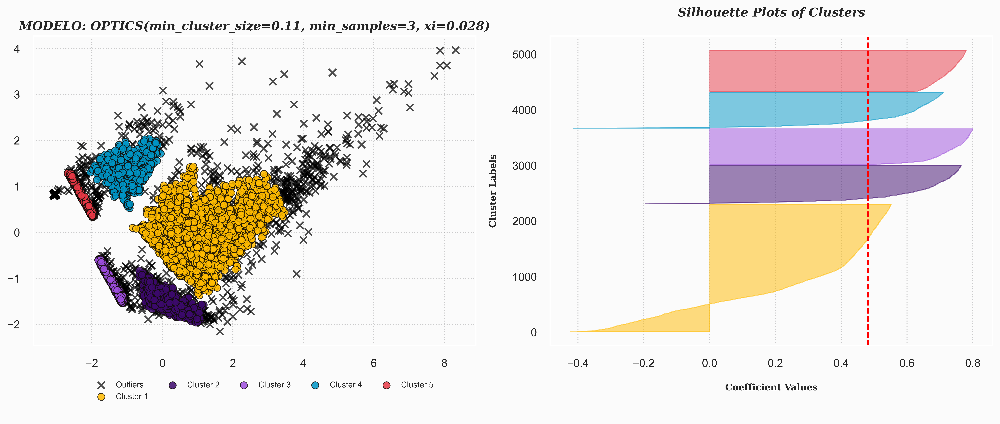

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  2.641
.: Silhouette Score:  0.341
.: Calinski Harabasz Index:  1512.23


In [76]:
###################################################################
# OPTICS
# Descripción: Similar a DBSCAN, pero permite detectar clusters con diferentes densidades.
# Indicación: Adecuado para datos donde la densidad de los clusters varía significativamente.
# Ventajas: No es necesario definir épsilon. Maneja mejor clusters con diferentes densidades. Detecta estructuras más complejas que DBSCAN.
# Desventajas: Computacionalmente más costoso que DBSCAN. Más complejo de interpretar que otros métodos.
# Supuestos: Similar a DBSCAN, pero permite diferentes densidades.
# Hiperparámetros: 
#     xi: controla la sensibilidad para detectar cambios en la densidad de los clusters.
#     Min pts (min samples): Define cuantos puntos necesita un vecindario para que un punto sea considerado núcleo.
#     min_cluster_size: Determina el tamaño mínimo de un cluster como fracción total de datos.
###################################################################
optics = OPTICS(min_samples=3, xi=0.028, min_cluster_size=0.11)
y_optics = optics.fit_predict(X)
plot_combined(optics, y_optics)
###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################
db_optics, ss_optics, ch_optics = evaluate_clustering(X, y_optics)


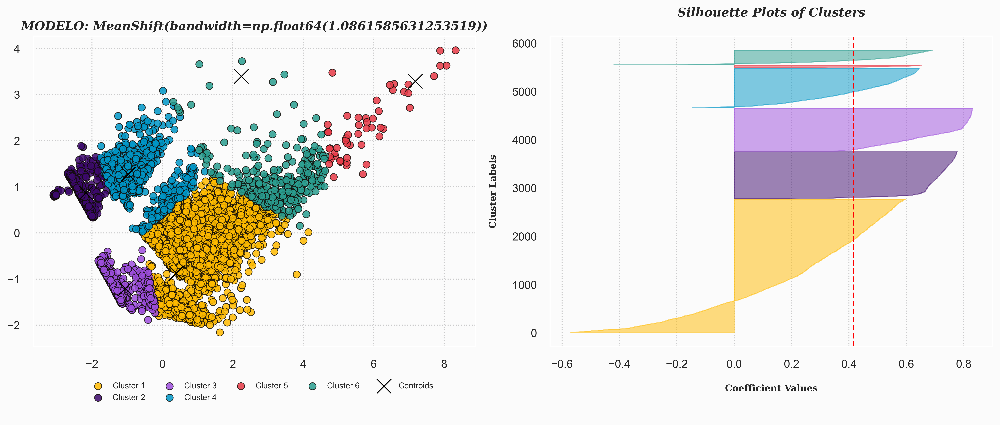

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  0.66
.: Silhouette Score:  0.415
.: Calinski Harabasz Index:  4682.463


In [77]:
###################################################################
# MEAN-SHIFT
# Descripción: Encuentra clusters desplazando puntos hacia regiones de mayor densidad.
# Indicación: Cuando no se conoce la cantidad de clusters y la densidad de los datos es variable.
# Ventajas: No se requiere especificar K. Funciona bien con clusters de formas arbitrarias.
# Desventajas: Computacionalmente costoso, no adecuado para grandes volumenes de datos.
# Supuestos: Los clusters están definidos por regiones de mayor densidad en el espacio de datos.
# Hiperparámetros: 
#     bandwidth: determina hasta que distancia un punto influye en los demás para formar clusters.
###################################################################
# Estimar automáticamente el ancho de banda adecuado
bandwidth = estimate_bandwidth(X, quantile=0.15, n_samples=200)
# Aplicar Mean-Shift
mshift = MeanShift(bandwidth=bandwidth)
y_mshift = mshift.fit_predict(X)
plot_combined(mshift, y_mshift)
###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################
db_mshift, ss_mshift, ch_mshift = evaluate_clustering(X, y_mshift)


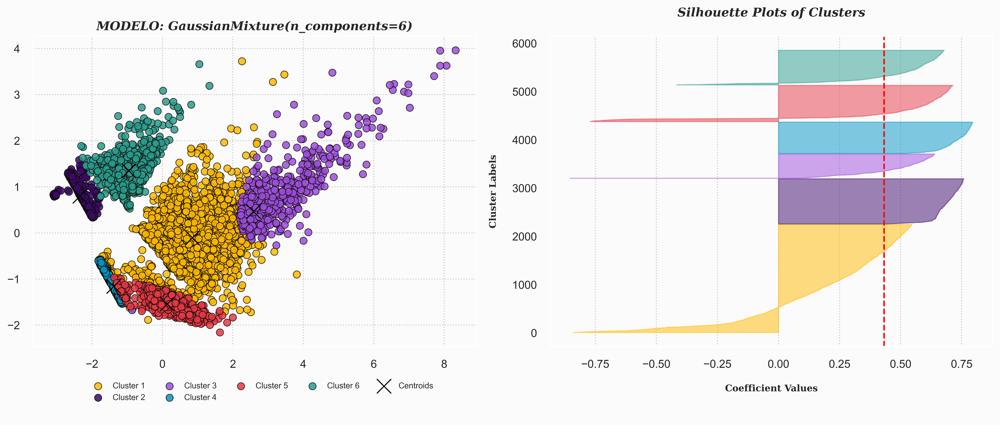

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  0.682
.: Silhouette Score:  0.432
.: Calinski Harabasz Index:  5834.251


In [78]:
###################################################################
# GAUSSIAN MIXTURE MODELS (GMM)
# Descripción: Modela los datos como una combinación de distribuciones gaussianas.
# Indicación: Datos con estructura probabilistica subyacente.
# Ventajas: Útil para datos que pueden solaparse. No asume clusters esféricos (como kmeans). Se puede usar para detección de outliers, al analizar probabilidades bajas.
# Desventajas: Necesario definir K previamente. Computacionalmente costoso.
# Supuestos: Cada clúster sigue una distribución gaussiana.
# Hiperparámetros: 
#     n_components: cantidad de distribuciones gaussianas (clusters).
###################################################################
gmm = GaussianMixture(n_components=6).fit(X)
y_gmm = gmm.predict(X)

plot_combined(gmm, y_gmm)
###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################
db_gmm, ss_gmm, ch_gmm = evaluate_clustering(X, y_gmm)


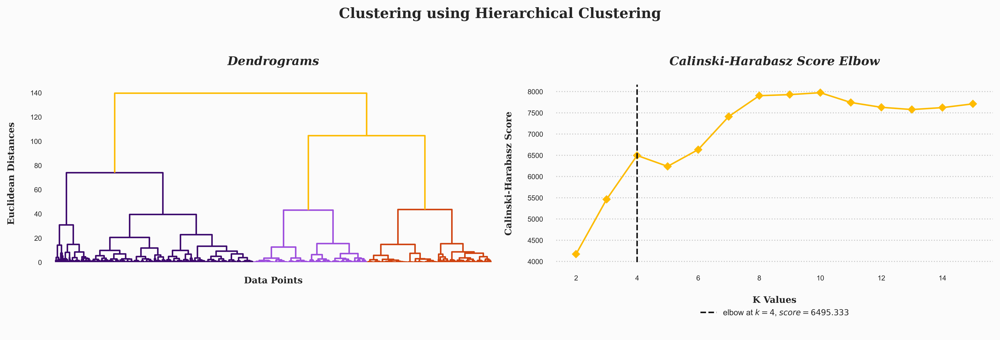

In [79]:
###################################################################
# GRÁFICA DE DENDROGRAMA Y ELBOW SCORE
#     Visualizar la cantidad recomendada de clusteres para el algoritmo jerárquico.
###################################################################

def agg_dendrogram():

    # --- Figure Settings ---
    color_palette=['#FFBB00', '#3C096C', '#9D4EDD', '#cf4311', '#cf8911', '#cfcf11', '#34cf11', '#1196cf', '#3411cf']
    set_palette(color_palette)
    text_style=dict(fontweight='bold', fontfamily='serif')
    ann=dict(textcoords='offset points', va='center', ha='center', fontfamily='serif', style='italic')
    title=dict(fontsize=12, fontweight='bold', style='italic', fontfamily='serif')
    bbox=dict(boxstyle='round', pad=0.3, color='#FFDA47', alpha=0.6)
    fig=plt.figure(figsize=(14, 5))

    # --- Dendrogram Plot ---
    ax1=fig.add_subplot(1, 2, 1)
    dend=shc.dendrogram(shc.linkage(X, method='ward', metric='euclidean'))
    #plt.axhline(y=115, color='#3E3B39', linestyle='--')
    plt.xlabel('\nData Points', fontsize=9, **text_style)
    plt.ylabel('Euclidean Distances\n', fontsize=9, **text_style)
    #plt.annotate('Horizontal Cut Line', xy=(15000, 130), xytext=(1, 1), fontsize=8, bbox=bbox, **ann)
    plt.tick_params(labelbottom=False)
    for spine in ax1.spines.values():
        spine.set_color('None')
    plt.grid(axis='both', alpha=0)
    plt.tick_params(labelsize=7)
    plt.title('Dendrograms\n', **title)

    # --- Elbow Score (Calinski-Harabasz Index) ---
    ax2=fig.add_subplot(1, 2, 2)
    elbow_score_ch = KElbowVisualizer(AgglomerativeClustering(), k=(2, 16), metric='calinski_harabasz', timings=False, ax=ax2)
    elbow_score_ch.fit(X)
    elbow_score_ch.finalize()
    elbow_score_ch.ax.set_title('Calinski-Harabasz Score Elbow\n', **title)
    elbow_score_ch.ax.tick_params(labelsize=7)
    for text in elbow_score_ch.ax.legend_.texts:
        text.set_fontsize(9)
    for spine in elbow_score_ch.ax.spines.values():
        spine.set_color('None')
    elbow_score_ch.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), borderpad=2, frameon=False, fontsize=8)
    elbow_score_ch.ax.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    elbow_score_ch.ax.grid(axis='x', alpha=0)
    elbow_score_ch.ax.set_xlabel('\nK Values', fontsize=9, **text_style)
    elbow_score_ch.ax.set_ylabel('Calinski-Harabasz Score\n', fontsize=9, **text_style)

    plt.suptitle('Clustering using Hierarchical Clustering\n', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();

# --- Calling Dendrogram Functions ---
agg_dendrogram();

El algoritmo seleccionado no tiene centroides definidos, solo se grafican los clusters.


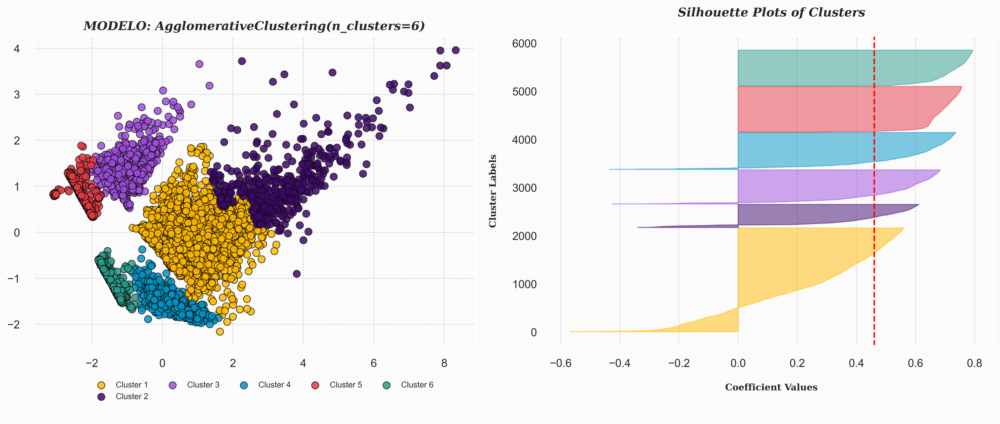

.: Evaluate Clustering Quality :.
**********************************
.: Davies-Bouldin Index:  0.658
.: Silhouette Score:  0.46
.: Calinski Harabasz Index:  6633.226


In [69]:
###################################################################
# CLUSTERING JERÁRQUICO
# Descripción: Construye una jerarquía de clusters fusionando (aglomerativo) o dividiendo (divisivo) grupos de datos.
# Indicación: Cuando no se conoce el número de clusters. Cuando el dataset es pequeño o mediano.
# Ventajas: Definir K de antemando es opcional.
# Desventajas: Muy costoso computacionalmente en tiempo y memoria para datasets grandes. Dificultad con datos ruidosos o con formas complejas.
# Supuestos: Los datos pueden agruparse de manera jerárquica. La métrica de distancia elegida influye fuertemente en el resultado.
# Hiperparámetros: 
#     n_clusters: cut-off en el dendrograma (determina cantidad de clusters).
#     metric: métrica de distancia. Determina como se mide la similitud entre puntos.
#     linkage: tipo de enlace. Determina el modo en que se mide la distancia entre clusters.
###################################################################
agg = AgglomerativeClustering(n_clusters=6, metric='euclidean', linkage='ward')
y_agg = agg.fit_predict(X)
plot_combined(agg, y_agg)

###################################################################
# EVALUAR BONDAD DEL CLUSTERING:

# Davies-Bouldin Index: Mientras mas bajo mejor, indica que los clusters son compactos y bien separados. Valores altos indican 
#    solapamiento y clusters mal definidos. Valores menores a 1 indican una buena separación entre clusteres.

# Silhouette Score: Mide qué tan bien están agrupados los puntos dentro de su cluster comparado con el cluster más cercano.
#    valores cercanos a 1 indican clusteres bien agrupados.
#    valores cercanos a 0 indican clusteres pobremente definidos (puntos en el límite de dos clusteres, conglomerados superpuestos).
#    valores cercanos a -1 indican mal clustering, los puntos están en el cluster incorrecto (existe un cluster de mayor similitud al caso).

# Calinski Harabasz Index: Mide la dispersión entre clusters en relación con la dispersión dentro de los clusters.
#    Mientras mas alto, mejor, ya que indican clusters bien separados y compactos
###################################################################
db_agg, ss_agg, ch_agg = evaluate_clustering(X, y_agg)

In [80]:
###################################################################
# TABLA COMPARATIVA DE TEST DE BONDAD
###################################################################

compare = pd.DataFrame({'Model': ['K-Means', 'K-Means++', 'DBSCAN', 'OPTICS', 'MEAN-SHIFT', 'GMM', 'Hierarchical Clustering'],
                        'Davies-Bouldin Index': [db_kmeans, db_kmeans_pplus, db_dbscan, db_optics, db_mshift, db_gmm, db_agg],
                        'Silhouette Score': [ss_kmeans, ss_kmeans_pplus, ss_dbscan, ss_optics, ss_mshift, ss_gmm, ss_agg],
                       'Calinski-Harabasz Index': [ch_kmeans, ch_kmeans_pplus, ch_dbscan, ch_optics, ch_mshift, ch_gmm, ch_agg]})

# --- Create Accuracy Comparison Table ---
print(clr.start+'.: Model Accuracy Comparison :.'+clr.end)
print(clr.color+'*' * 32+clr.end)
compare.sort_values(by='Calinski-Harabasz Index', ascending=False).style.background_gradient(cmap='inferno_r').hide().set_properties(**{'font-family': 'Segoe UI'})

.: Model Accuracy Comparison :.
********************************


Model,Davies-Bouldin Index,Silhouette Score,Calinski-Harabasz Index
K-Means++,0.688000,0.493000,8669.839000
K-Means,0.715000,0.479000,7863.163000
Hierarchical Clustering,0.658000,0.460000,6633.226000
GMM,0.682000,0.432000,5834.251000
MEAN-SHIFT,0.660000,0.415000,4682.463000
OPTICS,2.641000,0.341000,1512.230000
DBSCAN,1.483000,0.240000,833.056000


In [81]:
###################################################################
# CARACTERISTICAS DE CADA CLUSTER
###################################################################
def cluster_profiling(cl_res, stat):
    # Agregar etiquetas de clúster con conteo
    dfi['cluster_result'] = cl_res+1

    cluster_counts = dfi['cluster_result'].value_counts()
    dfi['cluster_result'] = dfi['cluster_result'].apply(lambda c: f"Cluster {c} ({cluster_counts[c]})" if c != 0 else f"Outlier ({cluster_counts[c]})")

    # Calcular la media por clúster y general
    df_profile = dfi.groupby('cluster_result').agg(stat).T.reset_index().rename(columns={'index': 'Column Name'})
    df_profile['Metric'] = stat

    # Calcular la media general y unirla en un solo paso
    if(stat == 'mean'):
        df_profile_overall = dfi.drop(columns=['cluster_result']).mean().rename('Overall').reset_index()
        r = 250
        g = 180
        b = 1
    if(stat == 'median'):
        df_profile_overall = dfi.drop(columns=['cluster_result']).median().rename('Overall').reset_index()
        r = 1
        g = 110
        b = 110
    if(stat == 'min'):
        df_profile_overall = dfi.drop(columns=['cluster_result']).min().rename('Overall').reset_index()
        r = 100
        g = 240
        b = 150
    if(stat == 'max'):
        df_profile_overall = dfi.drop(columns=['cluster_result']).max().rename('Overall').reset_index()
        r = 240
        g = 100
        b = 50
    if(stat == 'std'):
        df_profile_overall = dfi.drop(columns=['cluster_result']).std().rename('Overall').reset_index()
        r = 250
        g = 120
        b = 1
        
    df_profile = df_profile.merge(df_profile_overall, left_on='Column Name', right_on='index', how='left').drop(columns='index')

    # Función para asignar colores fila por fila
    def highlight_max_per_variable(row):
        colors = (row - row.min()) / (row.max() - row.min())
        return [f"background-color: rgba({r}, {g}, {b}, {a + 0.2}); color: black;" for a in colors]

    # Reordenar columnas y aplicar formato
    df_profile = df_profile[['Column Name', 'Metric'] + [col for col in df_profile.columns if col not in ['Column Name', 'Metric']]]
    styled_df = df_profile.style.apply(highlight_max_per_variable, axis=1, subset=df_profile.columns[2:])

    return(styled_df)


In [82]:
selected_model = y_agg

In [83]:
# Imprimir encabezado y mostrar la tabla
print(clr.start + '.: Summarize of Each Clusters :.' + clr.end)
print(clr.color + '*' * 33)
cluster_profiling(selected_model, 'mean')

.: Summarize of Each Clusters :.
*********************************


,Column Name,Metric,Cluster 1 (2154),Cluster 2 (479),Cluster 3 (707),Cluster 4 (766),Cluster 5 (947),Cluster 6 (744),Overall
0,q_recency_last_trx,mean,92.784705,40.248065,454.237376,52.188353,531.486401,133.910723,204.106673
1,sqa_sales,mean,2102.134112,10351.738190,1156.129676,1098.025576,303.558006,345.078185,2016.415102
2,lsqi_sales_2011,mean,1.237797,2.155660,0.000000,1.433751,0.000000,0.711132,0.918770
3,lsqi_sales_2010,mean,1.290994,2.445905,1.335795,0.000000,0.643473,0.000000,0.949830
4,lq_first_last_trx_span,mean,6.110271,6.437010,4.692343,4.503115,0.009166,0.028514,3.974749


In [84]:
# Imprimir encabezado y mostrar la tabla
print(clr.start + '.: Summarize of Each Clusters :.' + clr.end)
print(clr.color + '*' * 33)
cluster_profiling(selected_model, 'median')

.: Summarize of Each Clusters :.
*********************************


,Column Name,Metric,Cluster 1 (2154),Cluster 2 (479),Cluster 3 (707),Cluster 4 (766),Cluster 5 (947),Cluster 6 (744),Overall
0,q_recency_last_trx,median,57.486111,17.875000,427.920833,26.902431,527.959028,89.919444,99.958333
1,sqa_sales,median,1603.250000,8537.320000,773.050000,853.935000,221.650000,245.700000,842.040000
2,lsqi_sales_2011,median,1.098612,2.197225,0.000000,1.386294,0.000000,0.693147,0.693147
3,lsqi_sales_2010,median,1.386294,2.397895,1.098612,0.000000,0.693147,0.000000,0.693147
4,lq_first_last_trx_span,median,6.190885,6.504096,4.998441,4.638287,0.000000,0.000000,5.374667


In [85]:
# Imprimir encabezado y mostrar la tabla
print(clr.start + '.: Summarize of Each Clusters :.' + clr.end)
print(clr.color + '*' * 33)
cluster_profiling(selected_model, 'min')

.: Summarize of Each Clusters :.
*********************************


,Column Name,Metric,Cluster 1 (2154),Cluster 2 (479),Cluster 3 (707),Cluster 4 (766),Cluster 5 (947),Cluster 6 (744),Overall
0,q_recency_last_trx,min,1.037500,1.000694,351.927083,1.000000,353.879861,1.023611,1.000000
1,sqa_sales,min,30.950000,1951.820000,24.350000,62.430000,0.000000,0.000000,0.000000
2,lsqi_sales_2011,min,0.693147,0.000000,0.000000,0.693147,0.000000,0.693147,0.000000
3,lsqi_sales_2010,min,0.000000,0.000000,0.693147,0.000000,0.000000,0.000000,0.000000
4,lq_first_last_trx_span,min,0.004158,0.007610,0.000000,0.000000,0.000000,0.000000,0.000000


In [86]:
# Imprimir encabezado y mostrar la tabla
print(clr.start + '.: Summarize of Each Clusters :.' + clr.end)
print(clr.color + '*' * 33)
cluster_profiling(selected_model, 'max')

.: Summarize of Each Clusters :.
*********************************


,Column Name,Metric,Cluster 1 (2154),Cluster 2 (479),Cluster 3 (707),Cluster 4 (766),Cluster 5 (947),Cluster 6 (744),Overall
0,q_recency_last_trx,max,340.047222,438.855556,692.053472,318.966667,739.121528,338.870833,739.121528
1,sqa_sales,max,12601.830000,39916.500000,13916.340000,4873.810000,4376.250000,2626.300000,39916.500000
2,lsqi_sales_2011,max,3.218876,3.688879,0.000000,2.639057,0.000000,1.098612,3.688879
3,lsqi_sales_2010,max,2.890372,3.688879,3.637586,0.000000,1.386294,0.000000,3.688879
4,lq_first_last_trx_span,max,6.602695,6.604863,5.945052,6.583308,2.184958,3.134014,6.604863


In [87]:
# Imprimir encabezado y mostrar la tabla
print(clr.start + '.: Summarize of Each Clusters :.' + clr.end)
print(clr.color + '*' * 33)
cluster_profiling(selected_model, 'std')

.: Summarize of Each Clusters :.
*********************************


,Column Name,Metric,Cluster 1 (2154),Cluster 2 (479),Cluster 3 (707),Cluster 4 (766),Cluster 5 (947),Cluster 6 (744),Overall
0,q_recency_last_trx,std,90.812465,55.519110,81.861950,61.778008,118.355191,103.520380,209.638236
1,sqa_sales,std,1689.006353,6463.893756,1401.941759,817.919789,329.617443,326.902133,3413.043981
2,lsqi_sales_2011,std,0.524767,0.639611,0.000000,0.378227,0.000000,0.083534,0.775593
3,lsqi_sales_2010,std,0.502410,0.454998,0.400959,0.000000,0.222805,0.000000,0.797056
4,lq_first_last_trx_span,std,0.441131,0.339131,1.135084,0.977995,0.119796,0.243642,2.690520


In [88]:
###################################################################
# EXPORTAR A CSV
###################################################################
#preparar df con variables adicionales pero sin normalizar, para agregar la etiqueta del cluster
df['cluster_result'] = selected_model+1
cluster_counts = df['cluster_result'].value_counts()
df['cluster_result'] = df['cluster_result'].apply(lambda c: f"Cluster {c} ({cluster_counts[c]})" if c != 0 else f"Outlier ({cluster_counts[c]})")
outliers['cluster_result'] = 'outlier'
df = pd.concat([df, outliers])
df.to_csv('output/cluster_output.csv', sep=',')